In [ ]:
import pandas as pd
from pyabsa import AspectTermExtraction as ATEPC
from pyabsa import AspectPolarityClassification as APC


# find a suitable checkpoint and use the name:
aspect_extractor = ATEPC.AspectExtractor(
    checkpoint="checkpoints/ATE_EN",
)

# find a suitable checkpoint and use the name:
sentiment_classifier = APC.SentimentClassifier(
    checkpoint="checkpoints/EN_B_04_fast_lsa_t_v2_AttractionReviewEn_acc_91.42_f1_85.41"
)

In [1]:
import tqdm
import pandas as pd
def extract_aspect(text):
    text_aspect_extractor = aspect_extractor.predict(
        text=text,
        print_result=False,
        ignore_error=True,
        eval_batch_size=32,
        pred_sentiment=False,
        save_result=False,
    )
    return text_aspect_extractor

def extract_aspects(texts):
    texts_aspect_extractor = aspect_extractor.batch_predict(
        target_file=texts,  # list of text
        save_result=False,
        print_result=False,  # print the result
        pred_sentiment=False,  # Predict the sentiment of extracted aspect terms
        )
    return texts_aspect_extractor

def get_inference_format(extracted_aspect):
    text = extracted_aspect
    # find the index
    idxs = []
    IOB_LIST = text['IOB']
    for i, tag in enumerate(IOB_LIST):
        if tag == 'B-ASP':
            idxs.append(i)

    # add the tag
    for idx in idxs:
        token = text['tokens'][idx]
        new_token = f'[B-ASP]{token}[E-ASP]'
        text['tokens'][idx] = new_token
    # convert to string
    sentence = " ".join(text['tokens'])
    return sentence

def get_inference_format_from_list(list_of_extracted_aspects):
    inference_format = []
    for row in list_of_extracted_aspects:
        inference_format.append(get_inference_format(row))
    return inference_format

def predict_sentiment_from_list(texts):

    result_sentiments_classifier = []
    for text in tqdm.tqdm(texts):
        result_sentiments_classifier.append(predict_sentiment_from_text(text))
    # for text in texts:
    #     result_sentiments_classifier.append(predict_sentiment_from_text(text))
    pd.DataFrame(result_sentiments_classifier).to_json('Output/result_sentiments_classifier.json', orient='records')
    return result_sentiments_classifier

def predict_sentiment_from_text(text):
    result_sentiment_classifier = sentiment_classifier.predict(
        text=text,  # list of text
        print_result=False,  # print the result
        save_result=False,
        ignore_error=True,
    )
    return result_sentiment_classifier

# handle contractions in english
import re
contractions_dict = {
  "a'ight": "alright",
  "ain't": "am not",
  "amn't": "am not",
  "'n'": "and",
  "arencha": "aren’t you",
  "aren't": "are not",
  "‘bout": "about",
  "can't": "cannot",
  "cap’n": "captain",
  "'cause": "because",
  "’cept": "except",
  "could've": "could have",
  "couldn't": "could not",
  "couldn't've": "could not have",
  "cuppa": "cup of",
  "dammit": "damn it",
  "daren't": "dare not",
  "daresn't": "dare not",
  "dasn't": "dare not",
  "didn't": "did not",
  "doesn't": "does not",
  "don't": "do not",
  "dunno": "don't know",
  "d'ye": "do you",
  "d'ya": "do you",
  "e'en": "even",
  "e'er": "ever",
  "'em": "them",
  "everybody's": "everybody is",
  "everyone's": "everyone is",
  "finna": "fixing to",
  "fo’c’sle": "forecastle",
  "’gainst": "against",
  "g'day": "good day",
  "gimme": "give me",
  "giv'n": "given",
  "gi'z": "give us",
  "gonna": "going to",
  "gon't": "go not",
  "gotta": "got to",
  "hadn't": "had not",
  "had've": "had have",
  "hasn't": "has not",
  "haven't": "have not",
  "he'd": "he had",
  "he'll": "he shall",
  "helluva": "hell of a",
  "he's": "he has",
  "here's": "here is",
  "how'd": "how did",
  "howdy": "how do you do",
  "how'll": "how will",
  "how're": "how are",
  "how's": "how has",
  "I'd": "I had",
  "I'd've": "I would have",
  "I'd'nt": "I would not",
  "I'd'nt've": "I would not have",
  "I'll": "I shall",
  "I'm": "I am",
  "Imma": "I am about to",
  "I'm'o": "I am going to",
  "innit": "isn't it",
  "Ion": "I don't",
  "I've": "I have",
  "isn't": "is not",
  "it'd": "it would",
  "it'll": "it shall",
  "it's": "it has",
  "Idunno": "I don't know",
  "kinda": "kind of",
  "let's": "let us",
  "loven't": "love not",
  "ma'am": "madam",
  "mayn't": "may not",
  "may've": "may have",
  "methinks": "I think",
  "mightn't": "might not",
  "might've": "might have",
  "mustn't": "must not",
  "mustn't've": "must not have",
  "must've": "must have",
  "‘neath": "beneath",
  "needn't": "need not",
  "nal": "and all",
  "ne'er": "never",
  "o'clock": "of the clock",
  "o'er": "over",
  "ol'": "old",
  "ought've": "ought have",
  "oughtn't": "ought not",
  "oughtn't've": "ought not have",
  "‘round": "around",
  "'s": "is",
  "shalln't": "shall not",
  "shan't": "shall not",
  "she'd": "she had",
  "she'll": "she shall",
  "she's": "she has",
  "should've": "should have",
  "shouldn't": "should not",
  "shouldn't've": "should not have",
  "somebody's": "somebody has",
  "someone's": "someone has",
  "something's": "something has",
  "so're": "so are",
  "so’s": "so is",
  "so’ve": "so have",
  "that'll": "that shall",
  "that're": "that are",
  "that's": "that has",
  "that'd": "that would",
  "there'd": "there had",
  "there'll": "there shall",
  "there're": "there are",
  "there's": "there has",
  "these're": "these are",
  "these've": "these have",
  "they'd": "they had",
  "they'll": "they shall",
  "they're": "they are",
  "they've": "they have",
  "this's": "this has",
  "those're": "those are",
  "those've": "those have",
  "'thout": "without",
  "’til": "until",
  "'tis": "it is",
  "to've": "to have",
  "'twas": "it was",
  "'tween": "between",
  "'twere": "it were",
  "w'all": "we all",
  "w'at": "we at",
  "wanna": "want to",
  "wasn't": "was not",
  "we'd": "we had",
  "we'd've": "we would have",
  "we'll": "we shall",
  "we're": "we are",
  "we've": "we have",
  "weren't": "were not",
  "whatcha": "what are you what about you",
  "what'd": "what did",
  "what'll": "what shall",
  "what're": "what are",
  "what's": "what has",
  "what've": "what have",
  "when's": "when has",
  "where'd": "where did",
  "where'll": "where shall",
  "where're": "where are",
  "where's": "where has",
  "where've": "where have",
  "which'd": "which had",
  "which'll": "which shall",
  "which're": "which are",
  "which's": "which has",
  "which've": "which have",
  "who'd": "who would",
  "who'd've": "who would have",
  "who'll": "who shall",
  "who're": "who are",
  "who's": "who has",
  "who've": "who have",
  "why'd": "why did",
  "why're": "why are",
  "why's": "why has",
  "willn't": "will not",
  "won't": "will not",
  "wonnot": "will not",
  "would've": "would have",
  "wouldn't": "would not",
  "wouldn't've": "would not have",
  "y'ain't": "you are not",
  "y'all": "you all",
  "y'all'd've": "you all would have",
  "y'all'd'n't've": "you all would not have",
  "y'all're": "you all are",
  "y'all'ren't": "you all are not",
  "y'at": "you at",
  "yes’m": "yes ma’am",
  "y'know": "you know",
  "yessir": "yes sir",
  "you'd": "you had",
  "you'll": "you shall",
  "you're": "you are",
  "you've": "you have",
  "when'd": "when did"
}
contractions_pattern = re.compile('({})'.format('|'.join(contractions_dict.keys())), flags=re.IGNORECASE|re.DOTALL)

def expand_contractions(text):
  def expand_match(contraction):
      match = contraction.group(0)
      first_char = match[0]
      expanded_contraction = contractions_dict.get(match)\
          if contractions_dict.get(match)\
          else contractions_dict.get(match.lower())
      expanded_contraction = first_char+expanded_contraction[1:]
      return expanded_contraction
  try:
    expanded_text = contractions_pattern.sub(expand_match, text)
    expanded_text = re.sub("'", "", expanded_text)
  except:
    expanded_text = text
  return expanded_text

In [ ]:
reviews[47987]

In [ ]:
with open('integrated_datasets/predict_datasets/english_reviews.txt', 'r') as f:
    reviews = f.readlines()
    reviews = [x.lower().strip().replace('\xa0', ' ').replace('‘', "'").replace('’',"'") for x in reviews]
    reviews = [expand_contractions(x) for x in reviews]

In [ ]:
from utils import Notification
Notification.send('Aspect extraction started')
result_aspect_extractor = extract_aspects(reviews)

Notification.send('Inferring format started')
inference_input = get_inference_format_from_list(result_aspect_extractor)
Notification.send('Aspect extraction & create inference finished')

In [8]:
Notification.send('Sentiment prediction started')
result_sentiment_classifier = predict_sentiment_from_list(inference_input[70000:])
Notification.send('Sentiment prediction finished')
Notification.send('jangan lupa rename output file sebelum start lagi')

In [ ]:
result_sentiment_classifier

# Bahasa Indonesia

In [9]:
import pandas as pd
from pyabsa import AspectTermExtraction as ATEPC
from pyabsa import AspectPolarityClassification as APC


# find a suitable checkpoint and use the name:
aspect_extractor = ATEPC.AspectExtractor(
    checkpoint="checkpoints/ATE_ID",
)

# find a suitable checkpoint and use the name:
sentiment_classifier = APC.SentimentClassifier(
    checkpoint="checkpoints/ID_A_02_fast_lsa_t_v2_AttractionReviewId_acc_80.8_f1_76.25"
)

In [11]:
reviews = pd.read_csv('integrated_datasets/predict_datasets/indonesian_reviews.csv', delimiter=";", header=None)[3]

with open('integrated_datasets/predict_datasets/indonesian_reviews.txt', 'w') as f:
    for item in reviews:
        f.write(f"{item}\n")

In [12]:
# remove slang bahasa
import re, json, requests
url = 'https://raw.githubusercontent.com/farrelarrizal/PublicDataset/main/indonesian_slang_words.json'
slang_bahasa_dict = json.loads(requests.get(url).text)

def fix_slang(text):
    words = text.split(' ')
    for index, word in enumerate(words):
        if word in slang_bahasa_dict:
            words[index] = slang_bahasa_dict[word]
    return ' '.join(words)

In [13]:
with open('integrated_datasets/predict_datasets/indonesian_reviews.txt', 'r') as f:
    reviews = f.readlines()
    reviews = [x.lower().strip().replace('\xa0', ' ').replace('‘', "'").replace('’',"'") for x in reviews]
    reviews = [fix_slang(x) for x in reviews]

In [15]:
from utils import Notification
Notification.send('Aspect extraction started')
result_aspect_extractor = extract_aspects(reviews)

Notification.send('Inferring format started')
inference_input = get_inference_format_from_list(result_aspect_extractor)
Notification.send('Aspect extraction & create inference finished')

In [26]:
Notification.send('Sentiment prediction started')
result_sentiment_classifier = predict_sentiment_from_list(inference_input)
Notification.send('Sentiment prediction finished')
Notification.send('jangan lupa rename output file sebelum start lagi')

In [25]:
print('hai')

In [ ]:
predict_sentiment_from_text(inference_input[47987])

In [ ]:
text = pd.read_csv('integrated_datasets/predict_datasets/english_reviews.csv', delimiter=';', header=None)[3]
text = [x.lower().strip() for x in text.tolist()]

#create txt file
with open('integrated_datasets/predict_datasets/english_reviews.txt', 'w') as f:
    for item in text:
        f.write(f"{item}\n")

In [ ]:
atepc_examples = [
    "But the staff was so nice to us .",
    "But the staff was so horrible to us .",
    r"Not only was the food outstanding , but the little ` perks \' were great .",
    "It took half an hour to get our check , which was perfect since we could sit , have drinks and talk !",
    "It was pleasantly uncrowded , the service was delightful , the garden adorable , "
    "the food -LRB- from appetizers to entrees -RRB- was delectable .",
    "How pretentious and inappropriate for MJ Grill to claim that it provides power lunch and dinners !",
]

In [ ]:
text = 'But the staff was so nice to us .'
result_aspect_extractor = extract_aspect(text)

In [ ]:
inference = get_inference_format(result_aspect_extractor)
predict_sentiment_from_text(inference)

In [ ]:
reviews

In [ ]:
len(reviews)

In [ ]:

result_sentiment_classifier = predict_sentiment_from_list(inference_input[:10])

In [ ]:
len(inference_input)

In [ ]:
import time
start = time.time()
predict_sentiment_from_list(inference_input[:100])
end = time.time()
print(end - start)


In [ ]:
len(inference_input[:70000])

In [ ]:
from utils import Notification
Notification.send('Aspect extraction started')
result_aspect_extractor = extract_aspects(reviews)

Notification.send('Inferring format started')
inference_input = get_inference_format_from_list(result_aspect_extractor)

Notification.send('Sentiment prediction started')
result_sentiment_classifier = predict_sentiment_from_list(inference_input)


Notification.send('Aspect extraction & create inference & prediction finished')

In [ ]:
len(result_sentiment_classifier)

# predict the sentiment

In [ ]:
def predict_sentiment_from_list(texts):
    result_sentiment_classifier = sentiment_classifier.batch_predict(
        target_file=texts,  # list of text
        print_result=False,  # print the result
        save_result=False,
        ignore_error=True,
    )
    return result_sentiment_classifier

def predict_sentiment_from_text(text):
    result_sentiment_classifier = sentiment_classifier.predict(
        text=text,  # list of text
        print_result=False,  # print the result
        save_result=False,
        ignore_error=True,
    )
    return result_sentiment_classifier

In [ ]:
import tqdm
import warnings
warnings.filterwarnings('ignore')
for i in tqdm.tqdm(range(100)):
    predict_sentiment_from_list(inference_input[:100])


In [ ]:
Notification.send('Sentiment prediction started')
result_sentiment_classifier = predict_sentiment_from_list(inference_input)
Notification.send('Sentiment prediction finished')

In [ ]:
predict_sentiment_from_text('But the staff was so nice to us .')

In [ ]:
result_sentiment_classifier

In [ ]:
result_sentiment_classifier[4]

In [ ]:
pd.DataFrame(result_sentiment_classifier)

In [ ]:
# save the result
pd.DataFrame(result_sentiment_classifier).to_json('Output/result_sentiment_classifier_english.json', orient='records')

# EDA TOP 50 Bahasa Inggris

In [1]:
import pandas as pd
from wordcloud import WordCloud
from matplotlib import pyplot as plt
import seaborn as sns
import re

In [6]:
# a = pd.read_json('Output/result_sentiments_classifier_before70000.json')
# b = pd.read_json('Output/result_sentiments_classifier_after70000.json')
# c = pd.concat([a,b])
# c.to_json('Output/result_sentiments_classifier_english.json', orient='records')


In [2]:
data = pd.read_json('Output/result_sentiments_classifier_english.json')
data.head()

,text,aspect,sentiment,confidence,probs,ref_sentiment,ref_check,perplexity
0,after traveling to bali for the last 20 yrs fi...,[money],[Negative],[0.9984171391000001],[[9.9841714e-01 3.9638666e-04 1.1865273e-03]],[-100],[],N.A.
1,during our vacation we looked for some authent...,[food],[Positive],[0.9992628694000001],[[1.7051675e-04 5.6665239e-04 9.9926287e-01]],[-100],[],N.A.
2,"if you want to escape from the heat , do come ...","[view, water]","[Positive, Positive]","[0.9994262457, 0.9994450212]","[[1.2209169e-04 4.5164392e-04 9.9942625e-01], ...","[-100, -100]","[, ]",N.A.
3,"fantastic , fun cooking classes which our twin...","[cooking, hosting]","[Positive, Positive]","[0.9993188381, 0.9993494153]","[[1.3675947e-04 5.4441119e-04 9.9931884e-01], ...","[-100, -100]","[, ]",N.A.
4,we went with the whole family to the monkey fo...,"[guards, food, monkeys]","[Negative, Neutral, Neutral]","[0.9945161939, 0.9979315996, 0.3636075556]","[[9.945162e-01 3.370453e-04 5.146695e-03], [1....","[-100, -100, -100]","[, , ]",N.A.


In [3]:
data_review = data.text.tolist()

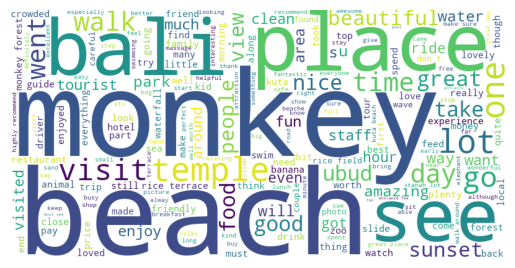

In [7]:
wordcloud = WordCloud(background_color='white', width=800, height=400).generate(' '.join(data_review))
# plt.figure(figsize=(12,10))
plt.imshow(wordcloud)
plt.axis('off')
plt.show()

In [58]:
data_review

['after traveling to bali for the last 20 yrs first time we have visited as had our 8yr granddaughter with us . all of us had a complete ball . starting with an unadventours 56 yr old a 53 pool lover and a 8 yr old water lover . a bit more money then most bali attractions but well worth it',
 'during our vacation we looked for some authentic food and found it . tested very good . we will come back .',
 "if you want to escape from the heat , do come here for a nice breeze as the weather here is very cooling and windy . not the mentioned the view is spectacular too ! take a walk and stop by the lake and take a dip into the cool and refreshing water , it ' s the best feeling you ever had ! although it ' s a 1 hour trip from kuta to here , but it is worth it and is a must to come here and take a selfie !",
 'fantastic , fun cooking classes which our twin 10 year old boys loved . we learned how to make 5 courses in a really simple way . the family hosting the course were excellent and very 

In [59]:
# remove punctuation
def remove_punctuation(data):
    result = []
    for s in data:
        clean_sentence = re.sub(r'[^\w\s]','',s)
        result.append(clean_sentence.strip())
    return result

data_review_remove_punctuation = remove_punctuation(data_review)

In [60]:
data_review_remove_punctuation

['after traveling to bali for the last 20 yrs first time we have visited as had our 8yr granddaughter with us  all of us had a complete ball  starting with an unadventours 56 yr old a 53 pool lover and a 8 yr old water lover  a bit more money then most bali attractions but well worth it',
 'during our vacation we looked for some authentic food and found it  tested very good  we will come back',
 'if you want to escape from the heat  do come here for a nice breeze as the weather here is very cooling and windy  not the mentioned the view is spectacular too  take a walk and stop by the lake and take a dip into the cool and refreshing water  it  s the best feeling you ever had  although it  s a 1 hour trip from kuta to here  but it is worth it and is a must to come here and take a selfie',
 'fantastic  fun cooking classes which our twin 10 year old boys loved  we learned how to make 5 courses in a really simple way  the family hosting the course were excellent and very hands on making the 

In [61]:
import nltk

def remove_stopwords(data_review, lang='english'):    # download the stopwords
    nltk.download('stopwords')
    from nltk.corpus import stopwords
    stopwords = stopwords.words(lang)

    result = []
    for s in data_review:
        clean_sentence = ''
        words = s.split(' ')
        for word in words:
            if word not in stopwords:
                clean_sentence += word + ' '
        result.append(clean_sentence.strip())
    return result

In [62]:
data_remove_stopwords = remove_stopwords(data_review_remove_punctuation)
data_remove_stopwords

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


['traveling bali last 20 yrs first time visited 8yr granddaughter us  us complete ball  starting unadventours 56 yr old 53 pool lover 8 yr old water lover  bit money bali attractions well worth',
 'vacation looked authentic food found  tested good  come back',
 'want escape heat  come nice breeze weather cooling windy  mentioned view spectacular  take walk stop lake take dip cool refreshing water   best feeling ever  although  1 hour trip kuta  worth must come take selfie',
 'fantastic  fun cooking classes twin 10 year old boys loved  learned make 5 courses really simple way  family hosting course excellent hands making whole experience great',
 'went whole family monkey forest  pay entrance guards everywhere watching monkeys visotors  keep aware take food monkeys find searching bags  buy bananas forest feed  really nothing special except fact walk around see monkeys fight live  little monkey zoo',
 'first time bali  took full day tour temples sightseeing  one famous uluwatu temple  ge

[Text(0, 0, '45708'),
 Text(0, 0, '33777'),
 Text(0, 0, '33579'),
 Text(0, 0, '32341'),
 Text(0, 0, '32011'),
 Text(0, 0, '23778'),
 Text(0, 0, '23451'),
 Text(0, 0, '23080'),
 Text(0, 0, '22797'),
 Text(0, 0, '22715')]

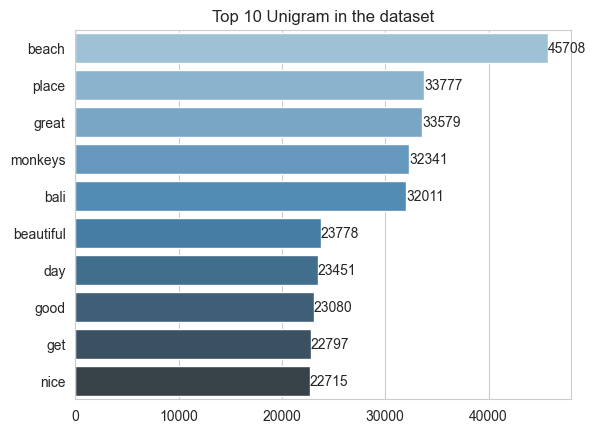

In [63]:
# visualize the wordcloud using barplot
#count the frequency of each word
from collections import Counter
word_freq = Counter(' '.join(data_remove_stopwords).split(' '))

#create df to sort values
import pandas as pd
df = pd.DataFrame.from_dict(word_freq, orient='index').reset_index()
df.columns = ['word', 'freq']
df = df.sort_values(by='freq', ascending=False)

# remove row 11 cause has empty string
df = df.drop(11)

# visualize the wordcloud using bar-plot
x,y = map(list, zip(*df.head(10).values))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 Unigram in the dataset')
g.bar_label(g.containers[0], label_type='edge',)

In [64]:
# Bigram Wordcloud
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from sklearn.feature_extraction.text import CountVectorizer

def get_top_topic_bigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2,2), stop_words=list(STOPWORDS)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

[Text(0, 0, '4934'),
 Text(0, 0, '3288'),
 Text(0, 0, '2858'),
 Text(0, 0, '2821'),
 Text(0, 0, '2747'),
 Text(0, 0, '2733'),
 Text(0, 0, '2546'),
 Text(0, 0, '2504'),
 Text(0, 0, '2463'),
 Text(0, 0, '2352')]

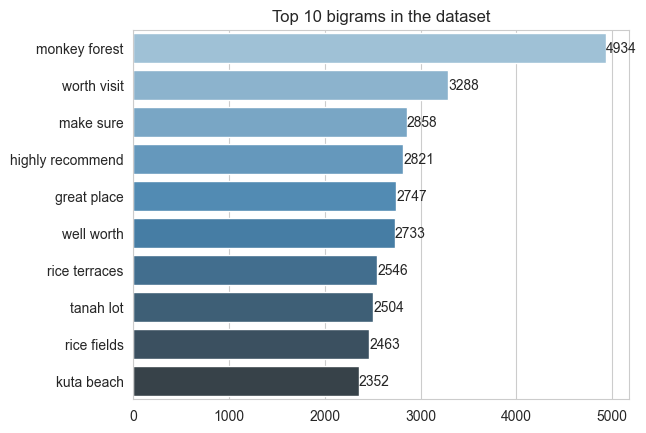

In [65]:
top_topic_bigrams = get_top_topic_bigrams(data_remove_stopwords, n=10)
x,y = map(list, zip(*top_topic_bigrams))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 bigrams in the dataset')
g.bar_label(g.containers[0], label_type='edge',)

In [66]:
def get_top_topic_trigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3,3), stop_words=list(STOPWORDS)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

[Text(0, 0, '903'),
 Text(0, 0, '816'),
 Text(0, 0, '715'),
 Text(0, 0, '675'),
 Text(0, 0, '568'),
 Text(0, 0, '558'),
 Text(0, 0, '546'),
 Text(0, 0, '506'),
 Text(0, 0, '504'),
 Text(0, 0, '431')]

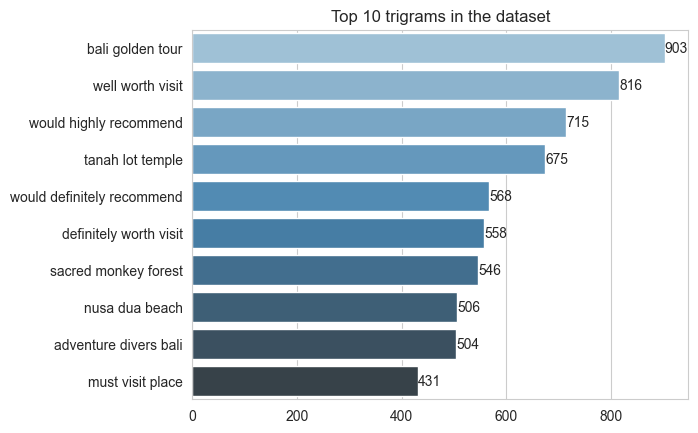

In [67]:
top_topic_trigrams = get_top_topic_trigrams(data_remove_stopwords, n=10)
x,y = map(list, zip(*top_topic_trigrams))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 trigrams in the dataset')
g.bar_label(g.containers[0], label_type='edge')

## Analyze the sentiment of the review

In [68]:
aspects = []
for aspect in data.aspect:
    for a in aspect:
        aspects.append(a)
aspects

['money',
 'food',
 'view',
 'water',
 'cooking',
 'hosting',
 'guards',
 'food',
 'monkeys',
 'uluwatu',
 'water',
 'place',
 'beach',
 'elephant',
 'time',
 'food',
 'service',
 'time',
 'monkeys',
 'temples',
 'rainforests',
 'Global Sentiment',
 'beach',
 'transport',
 'lady',
 'chairs',
 'tables',
 'vendors',
 'fee',
 'staff',
 'food',
 'views',
 'weather',
 'air',
 'view',
 'Global Sentiment',
 'walk',
 'tanah',
 'view',
 'spot',
 'band',
 'Global Sentiment',
 'beach',
 'water',
 'cleanliness',
 'place',
 'place',
 'Global Sentiment',
 'staff',
 'massage',
 'statues',
 'vishnu',
 'place',
 'monkeys',
 'value',
 'sanctuary',
 'monkeys',
 'bananas',
 'walk',
 'time',
 'fish',
 'fruit',
 'meal',
 'view',
 'crowds',
 'beach',
 'place',
 'sellers',
 'staff',
 'putri',
 'host',
 'lunch',
 'place',
 'gardens',
 'area',
 'sea',
 'bintang',
 'breakfast',
 'buffet',
 'pool',
 'keepers',
 'animals',
 'Global Sentiment',
 'bus',
 'monkey',
 'feeding',
 'price',
 'beach',
 'water',
 'driver',

In [69]:
aspects = ['<Global Sentiment>' if x == 'Global Sentiment' else x for x in aspects]

In [70]:
aspects

['money',
 'food',
 'view',
 'water',
 'cooking',
 'hosting',
 'guards',
 'food',
 'monkeys',
 'uluwatu',
 'water',
 'place',
 'beach',
 'elephant',
 'time',
 'food',
 'service',
 'time',
 'monkeys',
 'temples',
 'rainforests',
 '<Global Sentiment>',
 'beach',
 'transport',
 'lady',
 'chairs',
 'tables',
 'vendors',
 'fee',
 'staff',
 'food',
 'views',
 'weather',
 'air',
 'view',
 '<Global Sentiment>',
 'walk',
 'tanah',
 'view',
 'spot',
 'band',
 '<Global Sentiment>',
 'beach',
 'water',
 'cleanliness',
 'place',
 'place',
 '<Global Sentiment>',
 'staff',
 'massage',
 'statues',
 'vishnu',
 'place',
 'monkeys',
 'value',
 'sanctuary',
 'monkeys',
 'bananas',
 'walk',
 'time',
 'fish',
 'fruit',
 'meal',
 'view',
 'crowds',
 'beach',
 'place',
 'sellers',
 'staff',
 'putri',
 'host',
 'lunch',
 'place',
 'gardens',
 'area',
 'sea',
 'bintang',
 'breakfast',
 'buffet',
 'pool',
 'keepers',
 'animals',
 '<Global Sentiment>',
 'bus',
 'monkey',
 'feeding',
 'price',
 'beach',
 'water',


[Text(0, 0, '15642'),
 Text(0, 0, '14846'),
 Text(0, 0, '12867'),
 Text(0, 0, '8096'),
 Text(0, 0, '7826'),
 Text(0, 0, '7479'),
 Text(0, 0, '6771'),
 Text(0, 0, '5459'),
 Text(0, 0, '4940'),
 Text(0, 0, '3848')]

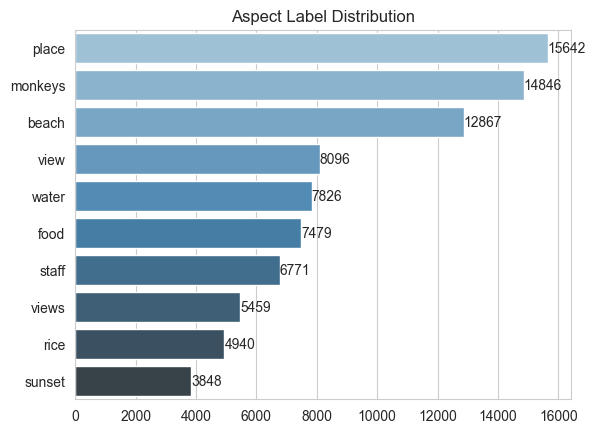

In [71]:
top_10_aspects = pd.Series(aspects).value_counts()[1:11]

# visualize the aspect label
g = sns.barplot(x=top_10_aspects.values, y=top_10_aspects.index, palette='Blues_d')
g.set_title('Aspect Label Distribution')
g.bar_label(g.containers[0], label_type='edge')

In [72]:
sentiments = []
for sentiment in data.sentiment:
    for s in sentiment:
        sentiments.append(s)
sentiments

['Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Neutral',
 'Neutral',
 'Positive',
 'Neutral',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Neutral',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Neutral',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Neutral',
 'Positive',
 'Neutral',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Negative',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Positive',
 'Neut

[Text(0, 0, '202894'), Text(0, 0, '38681'), Text(0, 0, '35297')]

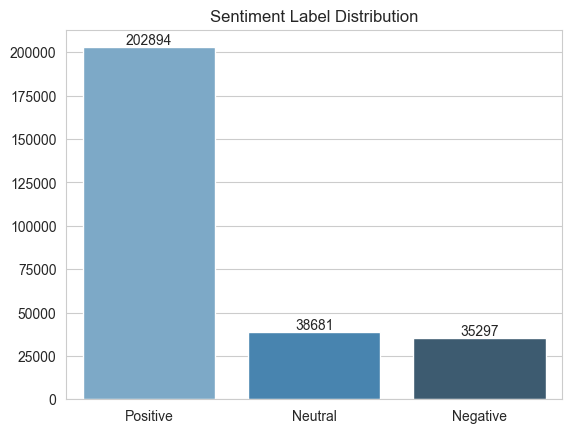

In [73]:
sentiment_polarity = pd.Series(sentiments).value_counts()

# visualize the sentiment label
g = sns.barplot(x=sentiment_polarity.index, y=sentiment_polarity.values, palette='Blues_d')
g.set_title('Sentiment Label Distribution')
g.bar_label(g.containers[0], label_type='edge')

In [74]:
sentiment_polarity
# get the positive value
pos = sentiment_polarity[0]
neu = sentiment_polarity[1]
neg = sentiment_polarity[2]

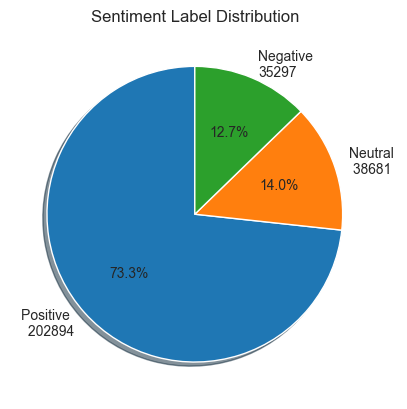

In [75]:
# pie chart
import matplotlib.pyplot as plt
labels = [f'Positive \n {pos}', f'Neutral \n {neu}', f'Negative \n{neg}']
plt.pie(sentiment_polarity.values, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)
plt.title('Sentiment Label Distribution')
plt.show()


In [76]:
new_df = data[['text']]
new_df

,text
0,after traveling to bali for the last 20 yrs fi...
1,during our vacation we looked for some authent...
2,"if you want to escape from the heat , do come ..."
3,"fantastic , fun cooking classes which our twin..."
4,we went with the whole family to the monkey fo...
...,...
141606,yep . lots of monkeys . not really a surprise ...
141607,i suggest going in the morning to enjoy it . i...
141608,"if you like long beach , this is the place you..."
141609,"please go down to the beach , totally worth it..."


In [77]:
data

,text,aspect,sentiment,confidence,probs,ref_sentiment,ref_check,perplexity
0,after traveling to bali for the last 20 yrs fi...,[money],[Negative],[0.9984171391000001],[[9.9841714e-01 3.9638666e-04 1.1865273e-03]],[-100],[],N.A.
1,during our vacation we looked for some authent...,[food],[Positive],[0.9992628694000001],[[1.7051675e-04 5.6665239e-04 9.9926287e-01]],[-100],[],N.A.
2,"if you want to escape from the heat , do come ...","[view, water]","[Positive, Positive]","[0.9994262457, 0.9994450212]","[[1.2209169e-04 4.5164392e-04 9.9942625e-01], ...","[-100, -100]","[, ]",N.A.
3,"fantastic , fun cooking classes which our twin...","[cooking, hosting]","[Positive, Positive]","[0.9993188381, 0.9993494153]","[[1.3675947e-04 5.4441119e-04 9.9931884e-01], ...","[-100, -100]","[, ]",N.A.
4,we went with the whole family to the monkey fo...,"[guards, food, monkeys]","[Negative, Neutral, Neutral]","[0.9945161939, 0.9979315996, 0.3636075556]","[[9.945162e-01 3.370453e-04 5.146695e-03], [1....","[-100, -100, -100]","[, , ]",N.A.
...,...,...,...,...,...,...,...,...
141606,yep . lots of monkeys . not really a surprise ...,[walk],[Positive],[0.9992585778],[[1.4331419e-04 5.9812906e-04 9.9925858e-01]],[-100],[],N.A.
141607,i suggest going in the morning to enjoy it . i...,[it],[Positive],[0.4860525429],[[0.11337976 0.40056765 0.48605254]],[-100],[],N.A.
141608,"if you like long beach , this is the place you...","[beach, pandawa]","[Positive, Positive]","[0.9993374944000001, 0.9985069633]","[[1.4458042e-04 5.1786756e-04 9.9933749e-01], ...","[-100, -100]","[, ]",N.A.
141609,"please go down to the beach , totally worth it...","[beach, pass, beach]","[Positive, Negative, Positive]","[0.9983931184, 0.9985110164000001, 0.9983916879]","[[4.7727770e-04 1.1296333e-03 9.9839312e-01], ...","[-100, -100, -100]","[, , ]",N.A.


In [78]:
# create df with index aspect
aspects_list = []
for i, row in data.iterrows():
    for r in row['aspect']:
        if r == 'Global Sentiment':
            r = '<Global Sentiment>'
        aspects_list.append([i, r])
aspects_list

# create df with index sentiment
sentiment_list = []
for i, row in data.iterrows():
    for r in row['sentiment']:
        sentiment_list.append([i, r])
sentiment_list

[[0, 'Negative'],
 [1, 'Positive'],
 [2, 'Positive'],
 [2, 'Positive'],
 [3, 'Positive'],
 [3, 'Positive'],
 [4, 'Negative'],
 [4, 'Neutral'],
 [4, 'Neutral'],
 [5, 'Positive'],
 [5, 'Neutral'],
 [6, 'Positive'],
 [7, 'Negative'],
 [8, 'Positive'],
 [8, 'Positive'],
 [8, 'Positive'],
 [8, 'Negative'],
 [8, 'Positive'],
 [9, 'Positive'],
 [9, 'Positive'],
 [9, 'Positive'],
 [10, 'Neutral'],
 [11, 'Positive'],
 [11, 'Negative'],
 [12, 'Positive'],
 [12, 'Positive'],
 [12, 'Positive'],
 [12, 'Positive'],
 [13, 'Positive'],
 [13, 'Positive'],
 [13, 'Positive'],
 [14, 'Positive'],
 [14, 'Positive'],
 [14, 'Positive'],
 [14, 'Positive'],
 [15, 'Positive'],
 [16, 'Negative'],
 [17, 'Positive'],
 [17, 'Positive'],
 [18, 'Positive'],
 [18, 'Neutral'],
 [19, 'Positive'],
 [20, 'Positive'],
 [20, 'Positive'],
 [20, 'Positive'],
 [21, 'Negative'],
 [22, 'Positive'],
 [23, 'Positive'],
 [24, 'Positive'],
 [24, 'Positive'],
 [25, 'Positive'],
 [25, 'Positive'],
 [25, 'Positive'],
 [26, 'Positive'],


In [79]:
aspects_df = pd.DataFrame(aspects_list, columns=['index', 'aspect'])
aspects_df

,index,aspect
0,0,money
1,1,food
2,2,view
3,2,water
4,3,cooking
...,...,...
276867,141608,pandawa
276868,141609,beach
276869,141609,pass
276870,141609,beach


In [80]:
sentiment_df = pd.DataFrame(sentiment_list, columns=['index', 'sentiment'])
aspects_df['sentiment'] = sentiment_df['sentiment']

In [81]:
df_aspect_sentiment = aspects_df
df_aspect_sentiment
# pd.merge(new_df, df_aspect_sentiment, left_index=True, right_on='index')

,index,aspect,sentiment
0,0,money,Negative
1,1,food,Positive
2,2,view,Positive
3,2,water,Positive
4,3,cooking,Positive
...,...,...,...
276867,141608,pandawa,Positive
276868,141609,beach,Positive
276869,141609,pass,Negative
276870,141609,beach,Positive


In [82]:
len(df_aspect_sentiment)

276872

In [83]:
pos_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Positive']['aspect']
neu_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Neutral']['aspect']
neg_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Negative']['aspect']

In [84]:
# wordcloud
from wordcloud import WordCloud

def show_wordcloud(data, title=None):
    wordcloud = WordCloud(background_color='white', width=800, height=400).generate(' '.join(data))
    plt.imshow(wordcloud)
    plt.axis('off')
    plt.title(title, fontsize=20)
    plt.show()


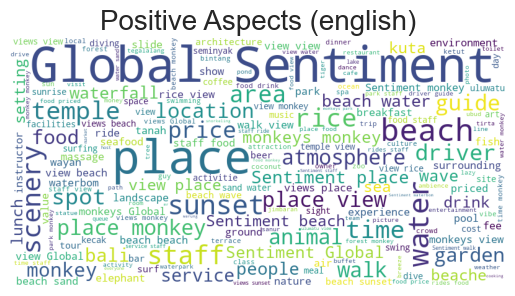

In [85]:
# wordcloud for positive aspects
show_wordcloud(pos_aspects, title='Positive Aspects (english)')

In [86]:
count_pos_aspects = pd.Series(pos_aspects).value_counts().head(10)
count_pos_aspects

aspect
place                 13883
monkeys                9831
beach                  9585
<Global Sentiment>     9217
view                   7851
staff                  6364
views                  5370
water                  4939
food                   4873
sunset                 3214
Name: count, dtype: int64

[Text(0, 0, '13883'),
 Text(0, 0, '9831'),
 Text(0, 0, '9585'),
 Text(0, 0, '9217'),
 Text(0, 0, '7851'),
 Text(0, 0, '6364'),
 Text(0, 0, '5370'),
 Text(0, 0, '4939'),
 Text(0, 0, '4873'),
 Text(0, 0, '3214')]

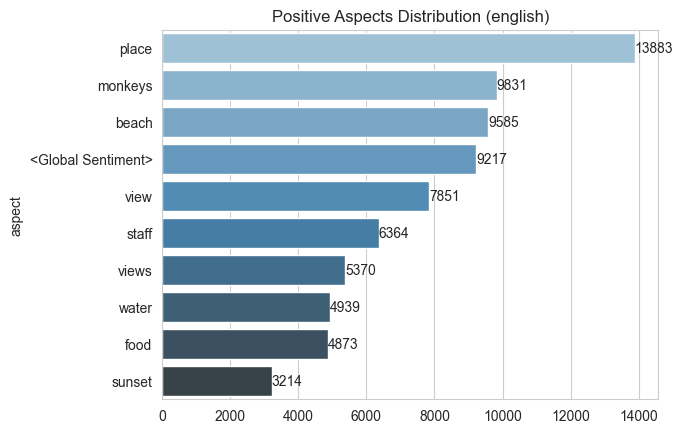

In [87]:
count_pos_aspects = pd.Series(pos_aspects).value_counts().head(10)

# visualize the aspect label
g = sns.barplot(x=count_pos_aspects.values, y=count_pos_aspects.index, palette='Blues_d')
g.set_title('Positive Aspects Distribution (english)')
g.bar_label(g.containers[0], label_type='edge')

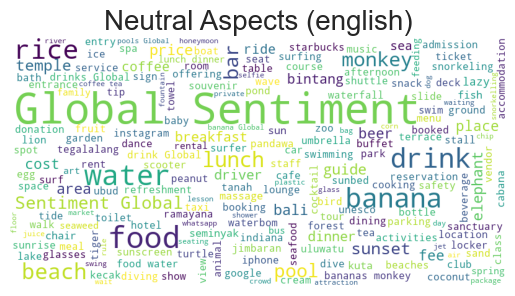

In [88]:
# neutral aspects
show_wordcloud(neu_aspects, title='Neutral Aspects (english)')

[Text(0, 0, '1992'),
 Text(0, 0, '1793'),
 Text(0, 0, '1459'),
 Text(0, 0, '1423'),
 Text(0, 0, '940'),
 Text(0, 0, '885'),
 Text(0, 0, '848'),
 Text(0, 0, '828'),
 Text(0, 0, '755'),
 Text(0, 0, '531')]

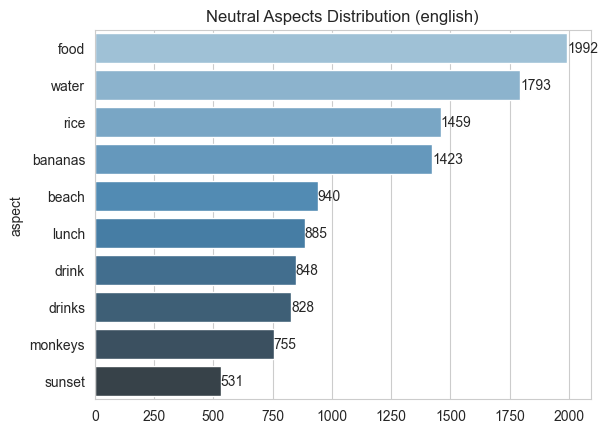

In [89]:
# barplot for neutral aspects
count_neu_aspects = pd.Series(neu_aspects).value_counts()[1:11]

# visualize the aspect label
g = sns.barplot(x=count_neu_aspects.values, y=count_neu_aspects.index, palette='Blues_d')
g.set_title('Neutral Aspects Distribution (english)')
g.bar_label(g.containers[0], label_type='edge')


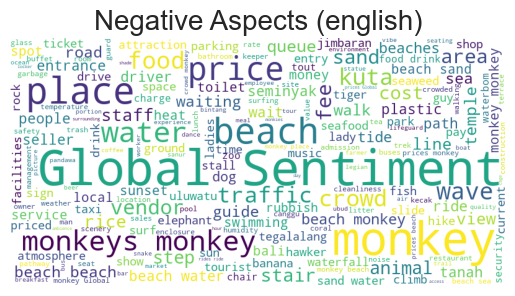

In [90]:
# negative aspects
show_wordcloud(neg_aspects, title='Negative Aspects (english)')

[Text(0, 0, '4260'),
 Text(0, 0, '2699'),
 Text(0, 0, '2342'),
 Text(0, 0, '1420'),
 Text(0, 0, '1094'),
 Text(0, 0, '863'),
 Text(0, 0, '614'),
 Text(0, 0, '559'),
 Text(0, 0, '542'),
 Text(0, 0, '538')]

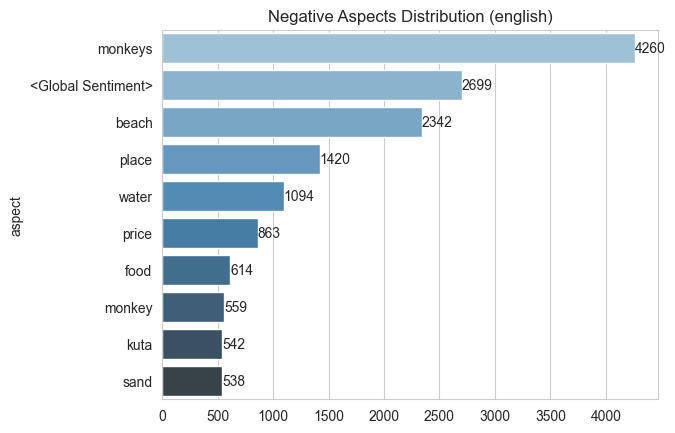

In [91]:
# barplot for negative aspects
count_neg_aspects = pd.Series(neg_aspects).value_counts().head(10)

# visualize the aspect label
g = sns.barplot(x=count_neg_aspects.values, y=count_neg_aspects.index, palette='Blues_d')
g.set_title('Negative Aspects Distribution (english)')
g.bar_label(g.containers[0], label_type='edge')



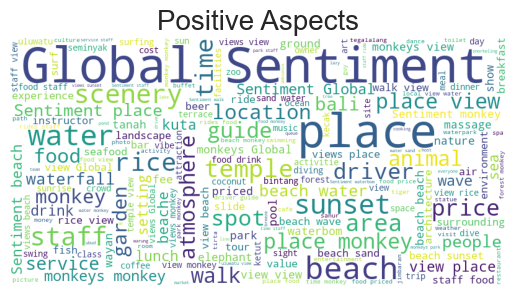

In [92]:
# wordcloud for positive aspects
wordcloud = WordCloud(background_color='white', width=800, height=400).generate(' '.join([x for x in pos_aspects]))
plt.imshow(wordcloud)
plt.axis('off')
plt.title('Positive Aspects', fontsize=20)
plt.show()



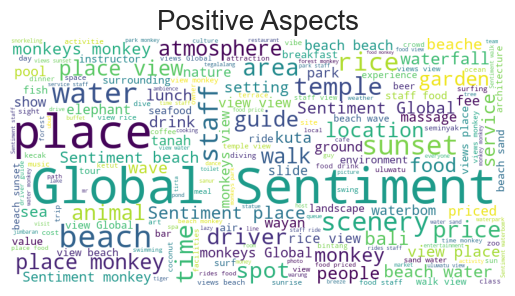

In [93]:
show_wordcloud(pos_aspects, title='Positive Aspects')

In [94]:
import re

In [95]:
data_remove_stopwords

['traveling bali last 20 yrs first time visited 8yr granddaughter us  us complete ball  starting unadventours 56 yr old 53 pool lover 8 yr old water lover  bit money bali attractions well worth',
 'vacation looked authentic food found  tested good  come back',
 'want escape heat  come nice breeze weather cooling windy  mentioned view spectacular  take walk stop lake take dip cool refreshing water   best feeling ever  although  1 hour trip kuta  worth must come take selfie',
 'fantastic  fun cooking classes twin 10 year old boys loved  learned make 5 courses really simple way  family hosting course excellent hands making whole experience great',
 'went whole family monkey forest  pay entrance guards everywhere watching monkeys visotors  keep aware take food monkeys find searching bags  buy bananas forest feed  really nothing special except fact walk around see monkeys fight live  little monkey zoo',
 'first time bali  took full day tour temples sightseeing  one famous uluwatu temple  ge

In [98]:
# remove punctuation using regex
def remove_punctuation(data):
    return re.sub(r'[^\w\s]', '', data)

data_review_remove_punctuation = remove_punctuation(' '.join(data_remove_stopwords))

In [99]:
data_review_remove_punctuation

'traveling bali last 20 yrs first time visited 8yr granddaughter us  us complete ball  starting unadventours 56 yr old 53 pool lover 8 yr old water lover  bit money bali attractions well worth vacation looked authentic food found  tested good  come back want escape heat  come nice breeze weather cooling windy  mentioned view spectacular  take walk stop lake take dip cool refreshing water   best feeling ever  although  1 hour trip kuta  worth must come take selfie fantastic  fun cooking classes twin 10 year old boys loved  learned make 5 courses really simple way  family hosting course excellent hands making whole experience great went whole family monkey forest  pay entrance guards everywhere watching monkeys visotors  keep aware take food monkeys find searching bags  buy bananas forest feed  really nothing special except fact walk around see monkeys fight live  little monkey zoo first time bali  took full day tour temples sightseeing  one famous uluwatu temple  getting temple quite ni

[Text(0, 0, '45708'),
 Text(0, 0, '33777'),
 Text(0, 0, '33579'),
 Text(0, 0, '32341'),
 Text(0, 0, '32011'),
 Text(0, 0, '23778'),
 Text(0, 0, '23451'),
 Text(0, 0, '23080'),
 Text(0, 0, '22797'),
 Text(0, 0, '22715')]

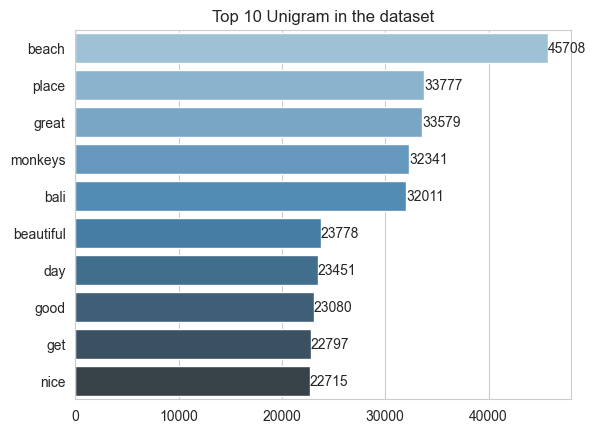

In [100]:
# visualize the wordcloud using barplot
#count the frequency of each word
from collections import Counter
word_freq = Counter(data_review_remove_punctuation.split(' '))

#create df to sort values
import pandas as pd
df = pd.DataFrame.from_dict(word_freq, orient='index').reset_index()
df.columns = ['word', 'freq']
df = df.sort_values(by='freq', ascending=False)

# # remove row 213 cause has empty string
# df = df.drop(0)

# visualize the wordcloud using bar-plot
x,y = map(list, zip(*df[1:11].values))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 Unigram in the dataset')
g.bar_label(g.containers[0], label_type='edge',)

In [101]:
from sklearn.feature_extraction.text import CountVectorizer
from wordcloud import STOPWORDS

In [102]:
def get_top_topic_bigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2,2), stop_words=list(STOPWORDS)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

## TOP 50 Bahasa Indonesia

In [125]:
import pandas as pd

In [103]:
data = pd.read_json('Output/result_sentiments_classifier_indonesia.json')

In [104]:
data

,text,aspect,sentiment,confidence,probs,ref_sentiment,ref_check,perplexity
0,tempat yang sakral sekali dibali setelah pura ...,"[tempat, pura, lokasi, lokasi]","[Neutral, Neutral, Positive, Positive]","[0.9561165571, 0.9965112805, 0.5173082352, 0.5...","[[0.00189766 0.95611656 0.04198578], [3.930282...","[-100, -100, -100, -100]","[, , , ]",N.A.
1,taman soekasada merupakan taman peninggalan ra...,[Global Sentiment],[Neutral],[0.9040299654],[[0.00149698 0.90402997 0.09447304]],[-100],[],N.A.
2,"tidak pantai terbaik di dunia , tapi ok juga u...","[pantai, jalan, jalur, restoran, daerah]","[Positive, Positive, Neutral, Positive, Positive]","[0.5808733106, 0.9969677329000001, 0.998384833...","[[0.41517136 0.00395535 0.5808733 ], [2.741842...","[-100, -100, -100, -100, -100]","[, , , , ]",N.A.
3,ini tempat taman wisata air paling lengkap di ...,[taman],[Positive],[0.9993603826],[[1.4613951e-04 4.9342838e-04 9.9936038e-01]],[-100],[],N.A.
4,"salah satu pantai terbaik di bali , di mana an...","[pantai, hotel, kursi, berjalan, tempat, laut]","[Positive, Negative, Neutral, Positive, Positi...","[0.9988431931, 0.5838789344, 0.8594656587, 0.9...","[[4.0084668e-04 7.5594237e-04 9.9884319e-01], ...","[-100, -100, -100, -100, -100, -100]","[, , , , , ]",N.A.
...,...,...,...,...,...,...,...,...
11267,"kami menginap di pullman hotel , sebrangnya ad...","[pullman, legian, pantai, kuta, legian, pullma...","[Neutral, Neutral, Neutral, Neutral, Neutral, ...","[0.9981366396, 0.9855753183, 0.9931938052, 0.9...","[[4.6431494e-04 9.9813664e-01 1.3990145e-03], ...","[-100, -100, -100, -100, -100, -100, -100]","[, , , , , , ]",N.A.
11268,htm gwk 60k tapi setelah masuk saya sampai kag...,[Global Sentiment],[Neutral],[0.9340729117000001],[[0.00203776 0.9340729 0.06388935]],[-100],[],N.A.
11269,hanya saya satu di sini dan ada tumpukan sarun...,"[sarung, aktivitas, pemandangan, kuta]","[Neutral, Positive, Positive, Neutral]","[0.9992489219, 0.5561367869, 0.9976577759, 0.9...","[[3.1059628e-04 9.9924892e-01 4.4047323e-04], ...","[-100, -100, -100, -100]","[, , , ]",N.A.
11270,wahana air yang paling ok . . semua wahananya ...,[Global Sentiment],[Positive],[0.9881629348000001],[[3.6943669e-04 1.1467713e-02 9.8816293e-01]],[-100],[],N.A.


In [105]:
# wordcloud text
data_review = data['text'].tolist()
data_review

['tempat yang sakral sekali dibali setelah pura uluwatu . . belum lengkap kebali kalau belum kesini , meski lokasi lumayan jauh tapi lokasi ini pelengkap kalau kebali . .',
 'taman soekasada merupakan taman peninggalan raja karangasem , berupa sebidang lahan yang terletak pada kontur tanah tebing di mana bagian bawahnya merupakan garis pantai ujung , bagian atasnya berbatasan langsung berupa bangunan hotel taman surgawi resort & spa . sebagai sebuah taman , lahannya sangat luas , mungkin lebih dari 4 ha . lahan itu terbagi menjadi beberapa bagian , yaitu : kebun , sawah , kolam bangunan dan jalan penghubung . beberap kolam menjadi daya tarik , karena bagian tengahnya didirikan bangunan semacam pendopo untuk penyimpanan koleksi foto - 2 peninggalan kerajaan . kesannya bangunan seperti',
 'tidak pantai terbaik di dunia , tapi ok juga untuk jalan kaki melewati di jalur yang disediakan . beberapa restoran yang bagus di daerah yang bagus yang ditawarkan kembali turun .',
 'ini tempat taman 

In [106]:
# remove punctuation
def remove_punctuation(data):
    result = []
    for s in data:
        clean_sentence = re.sub(r'[^\w\s]','',s)
        result.append(clean_sentence.strip())
    return result

data_review_remove_punctuation = remove_punctuation(data_review)

In [107]:
import nltk

def remove_stopwords(data_review, lang='english'):    # download the stopwords
    nltk.download('stopwords')
    from nltk.corpus import stopwords
    stopwords = stopwords.words(lang)

    result = []
    for s in data_review:
        clean_sentence = ''
        words = s.split(' ')
        for word in words:
            if word not in stopwords:
                clean_sentence += word + ' '
        result.append(clean_sentence.strip())
    return result

data_review_remove_stopwords = remove_stopwords(data_review_remove_punctuation, lang='indonesian')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\LENOVO\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [108]:
# wordcloud
from wordcloud import WordCloud

def show_wordcloud(data, title=None):
    wordcloud = WordCloud(background_color='white', width=800, height=400).generate(' '.join(data))

    fig = plt.figure(1, figsize=(15,15))
    plt.axis('off')
    if title:
        fig.suptitle(title, fontsize=20)
        fig.subplots_adjust(top=2.3)

    plt.imshow(wordcloud)
    plt.show()

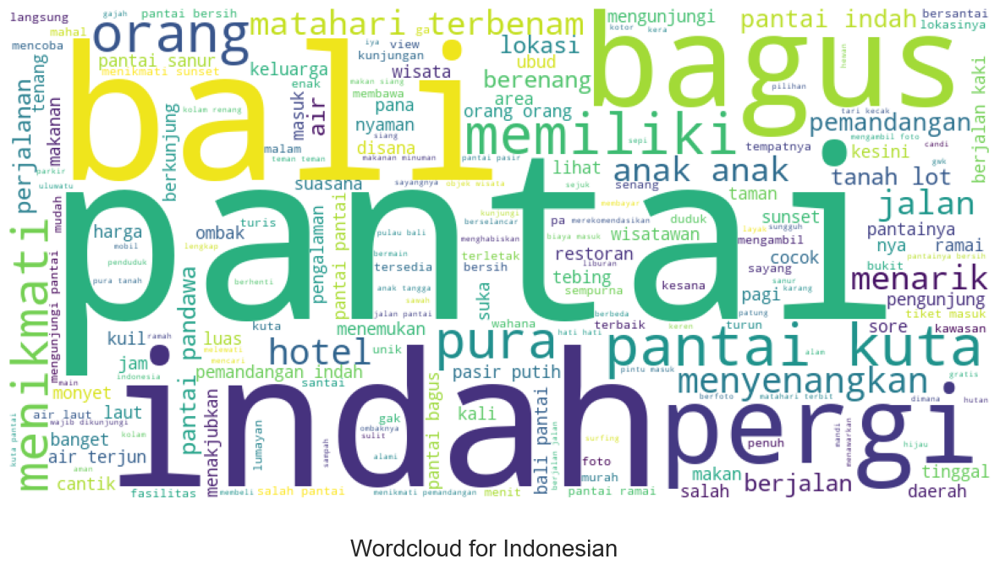

In [109]:
show_wordcloud(data_review_remove_stopwords, title='Wordcloud for Indonesian')

In [110]:
data_review_remove_stopwords[0]

'sakral dibali pura uluwatu   lengkap kebali kesini  lokasi lumayan lokasi pelengkap kebali'

[Text(0, 0, '9712'),
 Text(0, 0, '3475'),
 Text(0, 0, '3185'),
 Text(0, 0, '2463'),
 Text(0, 0, '2058'),
 Text(0, 0, '1953'),
 Text(0, 0, '1564'),
 Text(0, 0, '1499'),
 Text(0, 0, '1475'),
 Text(0, 0, '1473')]

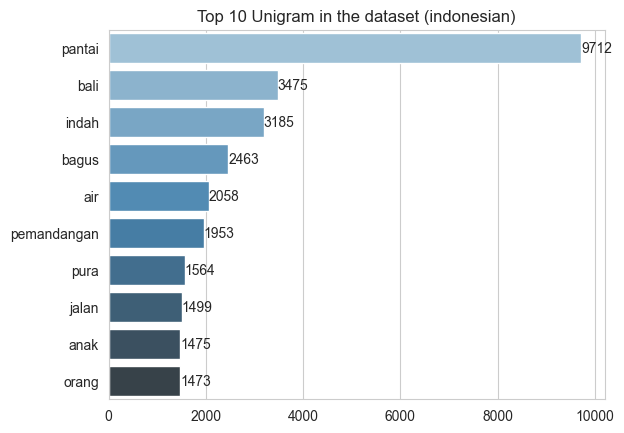

In [111]:
# top 10 unigram

# count the frequency of each word
from collections import Counter
word_freq = Counter(' '.join(data_review_remove_stopwords).split(' '))
word_freq

# create df to sort values
import pandas as pd
df = pd.DataFrame.from_dict(word_freq, orient='index').reset_index()
df.columns = ['word', 'freq']
df = df.sort_values(by='freq', ascending=False)

# remove row 4 cause has empty string
df = df.drop(4)

# visualize the wordcloud using bar-plot
x,y = map(list, zip(*df[0:10].values))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 Unigram in the dataset (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)

In [112]:
# Bigram Wordcloud
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from sklearn.feature_extraction.text import CountVectorizer

def get_top_topic_bigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(2,2), stop_words=list(STOPWORDS)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

[Text(0, 0, '816'),
 Text(0, 0, '538'),
 Text(0, 0, '531'),
 Text(0, 0, '506'),
 Text(0, 0, '457'),
 Text(0, 0, '433'),
 Text(0, 0, '395'),
 Text(0, 0, '375'),
 Text(0, 0, '323'),
 Text(0, 0, '290')]

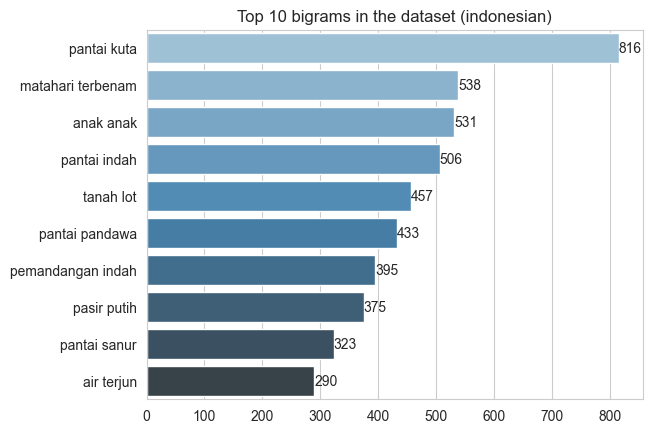

In [113]:
top_topic_bigrams = get_top_topic_bigrams(data_review_remove_stopwords, n=10)
x,y = map(list, zip(*top_topic_bigrams))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 bigrams in the dataset (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)

[Text(0, 0, '164'),
 Text(0, 0, '97'),
 Text(0, 0, '85'),
 Text(0, 0, '79'),
 Text(0, 0, '76'),
 Text(0, 0, '69'),
 Text(0, 0, '58'),
 Text(0, 0, '57'),
 Text(0, 0, '56'),
 Text(0, 0, '50')]

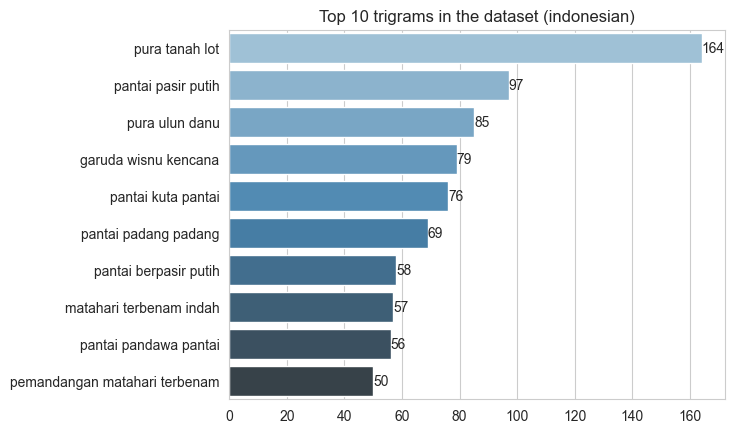

In [114]:
# Trigram Wordcloud
from nltk.corpus import stopwords
STOPWORDS = set(stopwords.words('english'))
from sklearn.feature_extraction.text import CountVectorizer

def get_top_topic_trigrams(corpus, n=None):
    vec = CountVectorizer(ngram_range=(3,3), stop_words=list(STOPWORDS)).fit(corpus)
    bag_of_words = vec.transform(corpus)
    sum_words = bag_of_words.sum(axis=0)
    words_freq = [(word, sum_words[0,idx]) for word, idx in vec.vocabulary_.items()]
    words_freq = sorted(words_freq, key=lambda x: x[1], reverse=True)
    return words_freq[:n]

top_topic_trigrams = get_top_topic_trigrams(data_review_remove_stopwords, n=10)
x,y = map(list, zip(*top_topic_trigrams))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Top 10 trigrams in the dataset (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)



In [157]:
data

,text,aspect,sentiment,confidence,probs,ref_sentiment,ref_check,perplexity
0,tempat yang sakral sekali dibali setelah pura ...,"[tempat, pura, lokasi, lokasi]","[Neutral, Neutral, Positive, Positive]","[0.9561165571, 0.9965112805, 0.5173082352, 0.5...","[[0.00189766 0.95611656 0.04198578], [3.930282...","[-100, -100, -100, -100]","[, , , ]",N.A.
1,taman soekasada merupakan taman peninggalan ra...,[Global Sentiment],[Neutral],[0.9040299654],[[0.00149698 0.90402997 0.09447304]],[-100],[],N.A.
2,"tidak pantai terbaik di dunia , tapi ok juga u...","[pantai, jalan, jalur, restoran, daerah]","[Positive, Positive, Neutral, Positive, Positive]","[0.5808733106, 0.9969677329000001, 0.998384833...","[[0.41517136 0.00395535 0.5808733 ], [2.741842...","[-100, -100, -100, -100, -100]","[, , , , ]",N.A.
3,ini tempat taman wisata air paling lengkap di ...,[taman],[Positive],[0.9993603826],[[1.4613951e-04 4.9342838e-04 9.9936038e-01]],[-100],[],N.A.
4,"salah satu pantai terbaik di bali , di mana an...","[pantai, hotel, kursi, berjalan, tempat, laut]","[Positive, Negative, Neutral, Positive, Positi...","[0.9988431931, 0.5838789344, 0.8594656587, 0.9...","[[4.0084668e-04 7.5594237e-04 9.9884319e-01], ...","[-100, -100, -100, -100, -100, -100]","[, , , , , ]",N.A.
...,...,...,...,...,...,...,...,...
11267,"kami menginap di pullman hotel , sebrangnya ad...","[pullman, legian, pantai, kuta, legian, pullma...","[Neutral, Neutral, Neutral, Neutral, Neutral, ...","[0.9981366396, 0.9855753183, 0.9931938052, 0.9...","[[4.6431494e-04 9.9813664e-01 1.3990145e-03], ...","[-100, -100, -100, -100, -100, -100, -100]","[, , , , , , ]",N.A.
11268,htm gwk 60k tapi setelah masuk saya sampai kag...,[Global Sentiment],[Neutral],[0.9340729117000001],[[0.00203776 0.9340729 0.06388935]],[-100],[],N.A.
11269,hanya saya satu di sini dan ada tumpukan sarun...,"[sarung, aktivitas, pemandangan, kuta]","[Neutral, Positive, Positive, Neutral]","[0.9992489219, 0.5561367869, 0.9976577759, 0.9...","[[3.1059628e-04 9.9924892e-01 4.4047323e-04], ...","[-100, -100, -100, -100]","[, , , ]",N.A.
11270,wahana air yang paling ok . . semua wahananya ...,[Global Sentiment],[Positive],[0.9881629348000001],[[3.6943669e-04 1.1467713e-02 9.8816293e-01]],[-100],[],N.A.


In [115]:
# create df with index aspect
aspects_list = []
for i, row in data.iterrows():
    for r in row['aspect']:
        if r == 'Global Sentiment':
            r = '<Global Sentiment>'
        aspects_list.append([i, r])

aspects_list

# create df with index sentiment
sentiment_list = []
for i, row in data.iterrows():
    for r in row['sentiment']:
        sentiment_list.append([i, r])
sentiment_list

[[0, 'Neutral'],
 [0, 'Neutral'],
 [0, 'Positive'],
 [0, 'Positive'],
 [1, 'Neutral'],
 [2, 'Positive'],
 [2, 'Positive'],
 [2, 'Neutral'],
 [2, 'Positive'],
 [2, 'Positive'],
 [3, 'Positive'],
 [4, 'Positive'],
 [4, 'Negative'],
 [4, 'Neutral'],
 [4, 'Positive'],
 [4, 'Positive'],
 [4, 'Positive'],
 [5, 'Negative'],
 [5, 'Neutral'],
 [5, 'Positive'],
 [5, 'Positive'],
 [5, 'Positive'],
 [5, 'Neutral'],
 [6, 'Positive'],
 [7, 'Positive'],
 [7, 'Positive'],
 [7, 'Positive'],
 [7, 'Neutral'],
 [8, 'Positive'],
 [9, 'Positive'],
 [9, 'Positive'],
 [9, 'Negative'],
 [9, 'Neutral'],
 [10, 'Positive'],
 [11, 'Positive'],
 [11, 'Positive'],
 [11, 'Positive'],
 [11, 'Positive'],
 [11, 'Positive'],
 [11, 'Neutral'],
 [11, 'Neutral'],
 [11, 'Neutral'],
 [12, 'Positive'],
 [12, 'Neutral'],
 [12, 'Neutral'],
 [13, 'Positive'],
 [13, 'Negative'],
 [13, 'Neutral'],
 [13, 'Neutral'],
 [14, 'Positive'],
 [14, 'Negative'],
 [14, 'Positive'],
 [14, 'Positive'],
 [14, 'Positive'],
 [14, 'Positive'],
 [14

In [116]:
# create df with index aspect
aspects_df = pd.DataFrame(aspects_list, columns=['index', 'aspect'])

# create df with index sentiment
sentiment_df = pd.DataFrame(sentiment_list, columns=['index', 'sentiment'])
aspects_df['sentiment'] = sentiment_df['sentiment']

# merge df
df_aspect_sentiment = aspects_df
df_aspect_sentiment

,index,aspect,sentiment
0,0,tempat,Neutral
1,0,pura,Neutral
2,0,lokasi,Positive
3,0,lokasi,Positive
4,1,<Global Sentiment>,Neutral
...,...,...,...
44486,11269,kuta,Neutral
44487,11270,<Global Sentiment>,Positive
44488,11271,pantai,Positive
44489,11271,perahu,Neutral


In [117]:
pos_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Positive']
neu_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Neutral']
neg_aspects = df_aspect_sentiment[df_aspect_sentiment['sentiment'] == 'Negative']


[Text(0, 0, '4532'),
 Text(0, 0, '2140'),
 Text(0, 0, '1470'),
 Text(0, 0, '971'),
 Text(0, 0, '588'),
 Text(0, 0, '552'),
 Text(0, 0, '537'),
 Text(0, 0, '470'),
 Text(0, 0, '441'),
 Text(0, 0, '424')]

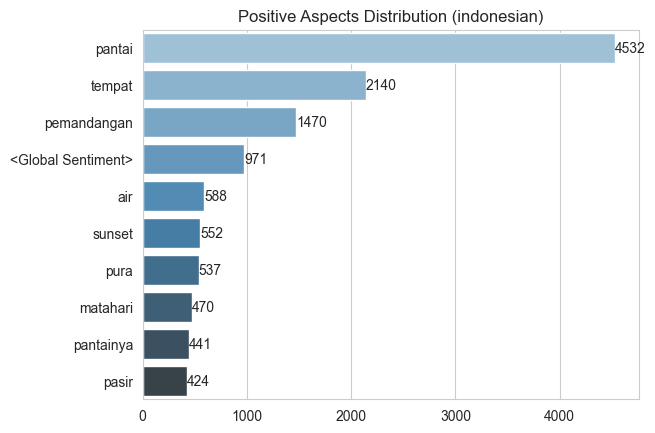

In [118]:
# top 10 aspect
x,y = map(list, zip(*Counter(pos_aspects['aspect']).most_common(10)))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Positive Aspects Distribution (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)

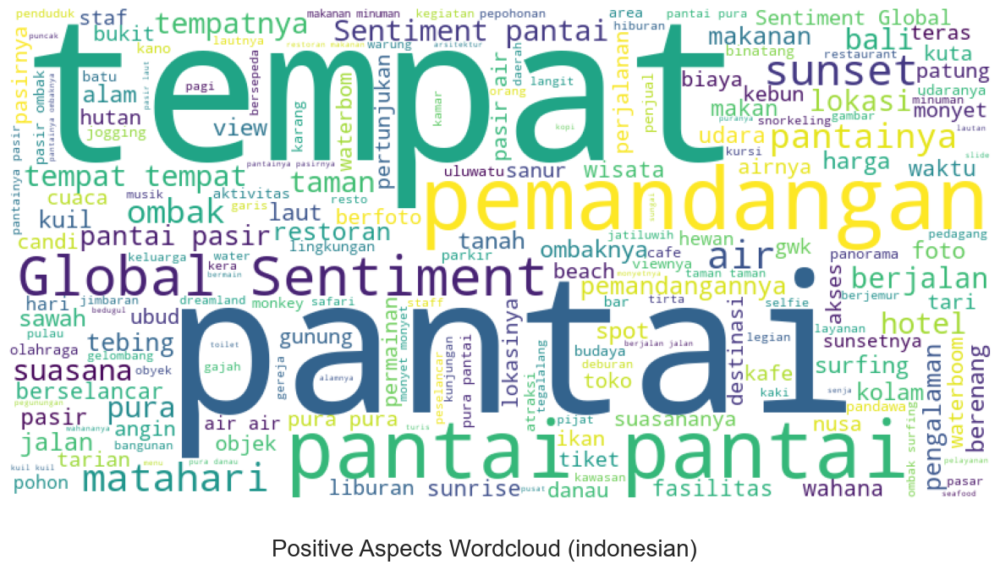

In [119]:
# positive aspects wordcloud
show_wordcloud(pos_aspects['aspect'], title='Positive Aspects Wordcloud (indonesian)')

[Text(0, 0, '1266'),
 Text(0, 0, '840'),
 Text(0, 0, '504'),
 Text(0, 0, '435'),
 Text(0, 0, '267'),
 Text(0, 0, '237'),
 Text(0, 0, '181'),
 Text(0, 0, '176'),
 Text(0, 0, '176'),
 Text(0, 0, '149')]

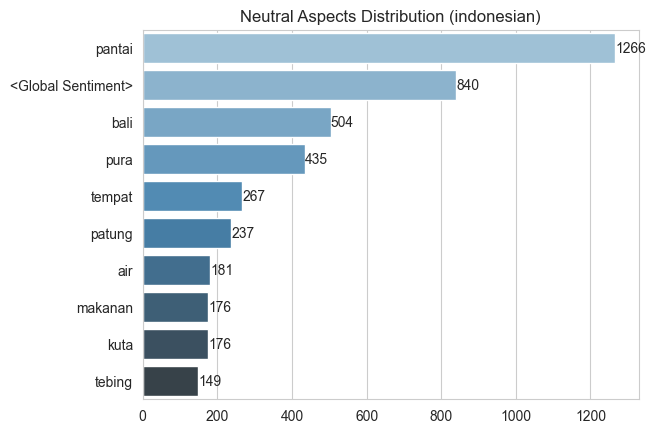

In [120]:
# top 10 aspect neutral
x,y = map(list, zip(*Counter(neu_aspects['aspect']).most_common(10)))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Neutral Aspects Distribution (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)


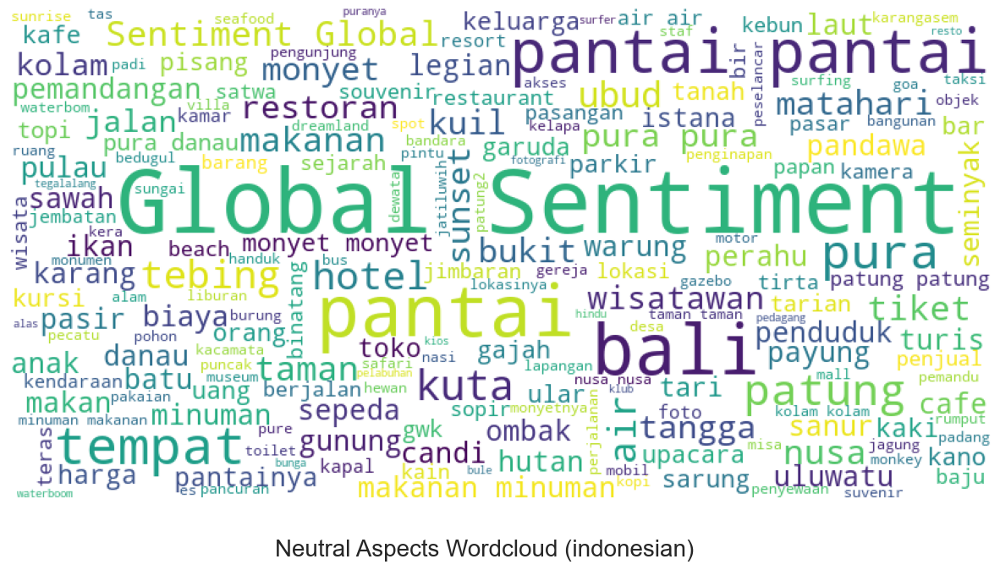

In [121]:
# neutral aspects wordcloud
show_wordcloud(neu_aspects['aspect'], title='Neutral Aspects Wordcloud (indonesian)')

[Text(0, 0, '370'),
 Text(0, 0, '193'),
 Text(0, 0, '177'),
 Text(0, 0, '96'),
 Text(0, 0, '94'),
 Text(0, 0, '91'),
 Text(0, 0, '89'),
 Text(0, 0, '79'),
 Text(0, 0, '64'),
 Text(0, 0, '56')]

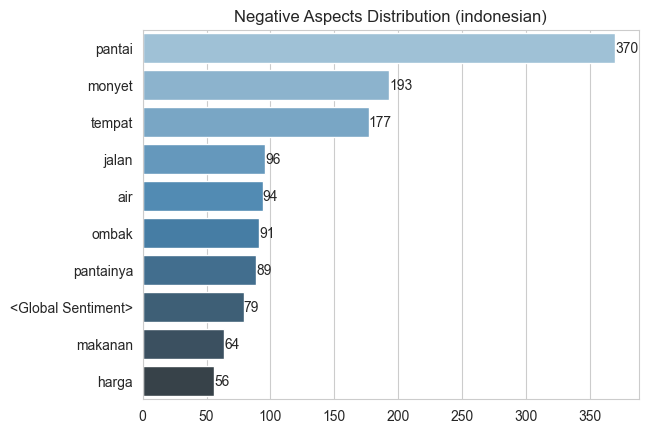

In [122]:
# top 10 aspect negative
x,y = map(list, zip(*Counter(neg_aspects['aspect']).most_common(10)))
g = sns.barplot(x=y, y=x, palette='Blues_d')
g.set_title('Negative Aspects Distribution (indonesian)')
g.bar_label(g.containers[0], label_type='edge',)

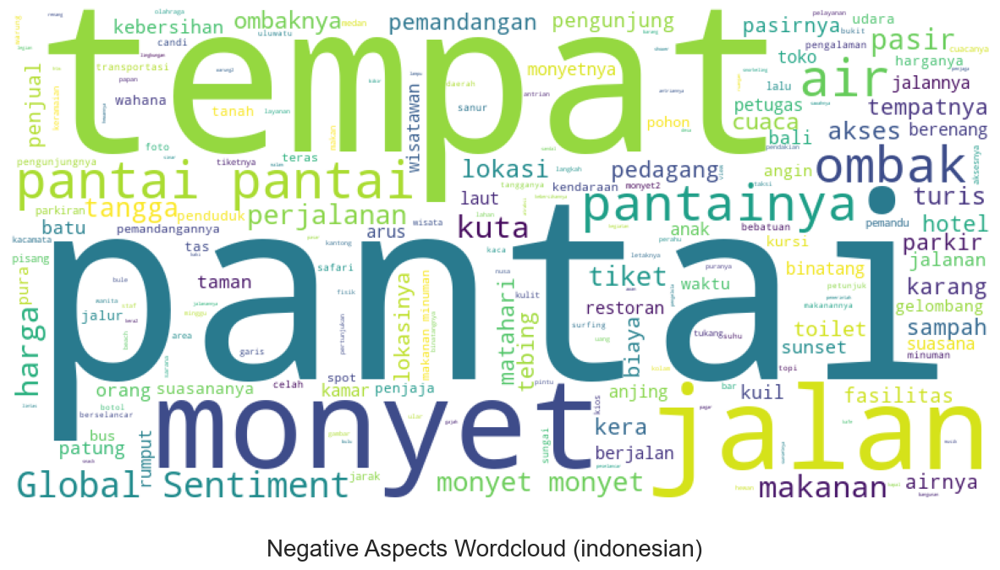

In [123]:
# negative aspects wordcloud
show_wordcloud(neg_aspects['aspect'], title='Negative Aspects Wordcloud (indonesian)')

In [124]:
pos_aspects

,index,aspect,sentiment
2,0,lokasi,Positive
3,0,lokasi,Positive
5,2,pantai,Positive
6,2,jalan,Positive
8,2,restoran,Positive
...,...,...,...
44484,11269,aktivitas,Positive
44485,11269,pemandangan,Positive
44487,11270,<Global Sentiment>,Positive
44488,11271,pantai,Positive


[Text(0, 0, '27735'), Text(0, 0, '12971'), Text(0, 0, '3785')]

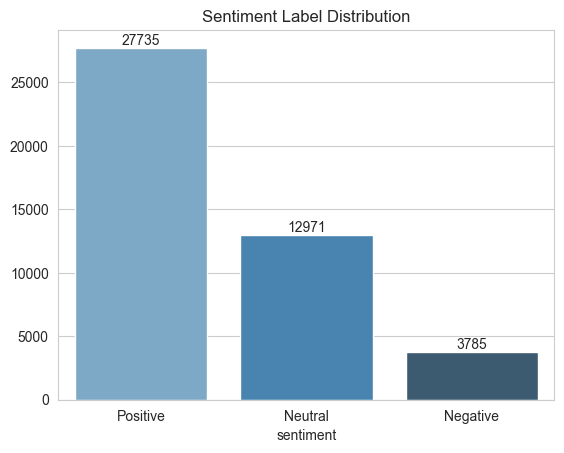

In [125]:
sentiment_polarity = sentiment_df.sentiment.value_counts()

# visualize the sentiment label
g = sns.barplot(x=sentiment_polarity.index, y=sentiment_polarity.values, palette='Blues_d')
g.set_title('Sentiment Label Distribution')
g.bar_label(g.containers[0], label_type='edge')

In [126]:
# get the positive value
pos = sentiment_polarity[0]
neu = sentiment_polarity[1]
neg = sentiment_polarity[2]

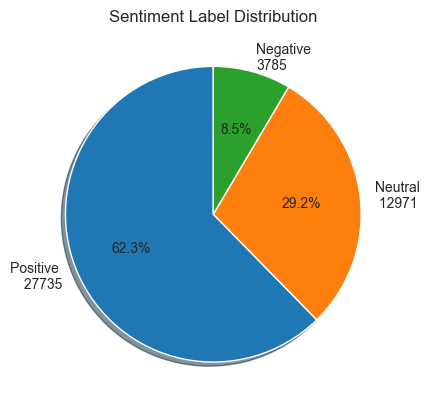

In [127]:
# pie chart
import matplotlib.pyplot as plt
labels = [f'Positive \n {pos}', f'Neutral \n {neu}', f'Negative \n{neg}']
plt.pie(sentiment_polarity.values, labels=labels, autopct='%1.1f%%', shadow=True, startangle=90)
plt.title('Sentiment Label Distribution')
plt.show()


In [130]:
aspects = []
for aspect in data.aspect:
    for a in aspect:
        if a == 'Global Sentiment':
            a = '<Global Sentiment>'
        aspects.append(a)
aspects

['tempat',
 'pura',
 'lokasi',
 'lokasi',
 '<Global Sentiment>',
 'pantai',
 'jalan',
 'jalur',
 'restoran',
 'daerah',
 'taman',
 'pantai',
 'hotel',
 'kursi',
 'berjalan',
 'tempat',
 'laut',
 'pantainya',
 'pantai2',
 'pantai',
 'sunrise',
 'suasana',
 'kapal',
 '<Global Sentiment>',
 'berjalan',
 'pantai',
 'tempat',
 'minuman',
 '<Global Sentiment>',
 'pengalaman',
 'hotel',
 'pisang',
 'banana',
 '<Global Sentiment>',
 'parkiran',
 'tegalalang',
 'tegalalang',
 'terasiring',
 'alam',
 'pendopo',
 'warung',
 'pos',
 'spot',
 'tari',
 'sun',
 'pasirnya',
 'tempatnya',
 'mobil',
 'waktu',
 'pantai',
 'akses',
 'kompleks',
 'pantainya',
 'karang',
 'foto',
 'pantai',
 'suasananya',
 'patung',
 'taman',
 'taman',
 'patung',
 'taman',
 'pantai',
 'pasir',
 'tempat',
 'pantai',
 'hotel',
 'pantai',
 'hotel',
 'pantai',
 'lingkungan',
 '<Global Sentiment>',
 'patung',
 'tempat',
 'obyek',
 'zoo',
 'bali',
 'harga',
 'satwanya',
 'siswa',
 'binatang',
 'pantai',
 'bali',
 'pantai',
 'pant

[Text(0, 0, '6168'),
 Text(0, 0, '2584'),
 Text(0, 0, '1890'),
 Text(0, 0, '1543'),
 Text(0, 0, '984'),
 Text(0, 0, '863'),
 Text(0, 0, '760'),
 Text(0, 0, '659'),
 Text(0, 0, '600'),
 Text(0, 0, '568')]

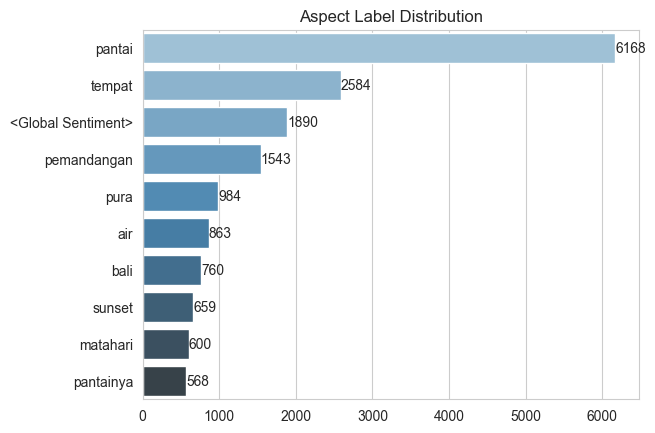

In [132]:
# Aspect Label Distribution
top_10_aspects = pd.Series(aspects).value_counts()[0:10]

# visualize the aspect label
g = sns.barplot(x=top_10_aspects.values, y=top_10_aspects.index, palette='Blues_d')
g.set_title('Aspect Label Distribution')
g.bar_label(g.containers[0], label_type='edge')